In [102]:
%load_ext autoreload
%autoreload 2
%cd /home/florian/GitRepos/activeCell-ACDC
!ls

import json
import random as rd
import matplotlib.image as mpimg
import cv2
import wandb
import torch
import os
import logging
import pandas as pd
import collections
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import pyplot


from detectron2.utils.visualizer import Visualizer
from detectron2.utils.logger import setup_logger
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.modeling import build_model
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.engine import DefaultPredictor
from detectron2.checkpoint import DetectionCheckpointer

from detectron2.structures.masks import polygons_to_bitmask

from src.globals import *
from utils.visualization.show_image import show_image, plot_prediction
from utils.register_datasets import register_datasets, get_dataset_name
from utils.config_builder import get_config
from utils.notebook_utils import *
from utils.evaluation import SingleImageCOCOEvaluator
from utils.evaluation_accuracy import AccuracyEvaluator


from src.test import do_test
from src.active_learning.al_trainer import *
from src.active_learning.mc_dropout_sampler import *
from src.active_learning.tta_sampler import *


logger = setup_logger(output="./log/main.log",name="null_logger") 
logger.addHandler(logging.NullHandler())
logging.getLogger('detectron2').setLevel(logging.WARNING)
logging.getLogger('detectron2').addHandler(logging.NullHandler())

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
/home/florian/GitRepos/activeCell-ACDC
ac_acdc_env				   notebooks
al_output				   output
chlamy_dataset_test_coco_format.json.lock  pipeline_configs
coco_instances_results.json		   README.md
data					   requirements.txt
experiments				   shell_scripts
instances_predictions.pth		   src
local					   utils
log					   wandb


In [3]:
dataset = CHLAMY_DATASET
config_name = "classes_acdc_large_al"

model_path = "/home/florian/GitRepos/activeCell-ACDC/al_output/classes_acdc_large_al/random"

register_datasets()
train_data = DatasetCatalog.get(get_dataset_name(
    dataset, DATASETS_DSPLITS[dataset][0]
))

test_data = DatasetCatalog.get(get_dataset_name(
    dataset, DATASETS_DSPLITS[dataset][1]
))


registering acdc_large_cls dataset
registering chlamy_dataset dataset


In [3]:
def plot_gt(image_id, data_json):
    cfg = get_cfg()
    cfg.DATASETS.TRAIN = get_dataset_name(dataset, DATASETS_DSPLITS[dataset][0])
    in_image_json = list(
        filter(lambda image_json: image_json["image_id"] == image_id, data_json)
    )[0]
    in_image = cv2.imread(in_image_json["file_name"])  # imgs[0]
    visualizer = Visualizer(
        in_image[:, :, ::-1],
        metadata=MetadataCatalog.get(cfg.DATASETS.TRAIN[0]),
        scale=2,
    )
    out = visualizer.draw_dataset_dict(in_image_json)
    out_image = out.get_image()[:, :, ::-1]
    show_image(out_image)


def plot_hist(array):
    sns.set_context("talk")
    a4_dims = (20, 8.27)
    fig, ax = pyplot.subplots(figsize=a4_dims)
    sns.histplot(data=np.array(array))
    plt.xlabel('Volume of cells in pixels')

def plot_hist_experiments(data_df):
    sns.set_context("talk")
    a4_dims = (20, 8.27)
    fig, ax = pyplot.subplots(figsize=a4_dims)
    g = sns.histplot(data=data_df, x="pixel_vol", hue="Experiment")
    plt.xlabel('Volume of cells in pixels')



def plot_hist_class(data_df):
    sns.set_context("talk")
    a4_dims = (20, 8.27)
    fig, ax = pyplot.subplots(figsize=a4_dims)
    sns.histplot(data=data_df, x="pixel_vol", hue="Cell Cycle Stage")
    plt.xlabel('Volume of cells in pixels')

In [4]:
print(f"total images: \t {len(test_data) + len(train_data)}")
print(f"train images: \t {len(train_data)}")
print(f"test images: \t {len(test_data)}")

total images: 	 523
train images: 	 439
test images: 	 84


In [5]:
def get_exp_dict(data_jsons):
    pos_dict = {}

    for image_json in data_jsons:
        id = image_json["image_id"]
        num_objects = len(image_json["annotations"])
        experiment = id.split("_pos")[0]
        frame_id = id.split("_")[-1]
        position = "_".join(id.replace(f"{experiment}_","").split("_")[:-1])

        if position.find("_") == -1:
            print(id)

        if experiment in pos_dict.keys():
            if position in pos_dict[experiment].keys():
                pos_dict[experiment][position].append([frame_id, num_objects])
            else:
                pos_dict[experiment][position] = [[frame_id, num_objects]]
        else:
            pos_dict[experiment] = {position:[[frame_id, num_objects]]}

    return pos_dict

total_data = train_data + test_data
total_pos_dict = get_exp_dict(total_data)
train_pos_dict = get_exp_dict(train_data)
test_pos_dict = get_exp_dict(test_data)

In [6]:
def print_dict_info(pos_dict):
    total_pos = 0
    for experiment in list(pos_dict.keys()):
        print(experiment, "num positions: ", len(list(pos_dict[experiment].keys())))
        total_pos += len(list(pos_dict[experiment].keys()))
        #for position in list(pos_dict[experiment].keys()):
            #print("\t", position, "num frames: ", len(pos_dict[experiment][position]))
    print(f"num pos: {total_pos}")

In [7]:
print("\ntotal:")
print_dict_info(total_pos_dict)


total:
1 by 125 num positions:  5
1 by 250 num positions:  5
1 by 31.25 num positions:  5
1 by 500 num positions:  5
1 by 62.5 num positions:  5
num pos: 25


In [8]:
print("train:")
print_dict_info(train_pos_dict)

train:
1 by 125 num positions:  4
1 by 250 num positions:  4
1 by 31.25 num positions:  5
1 by 500 num positions:  3
1 by 62.5 num positions:  5
num pos: 21


In [9]:
print("test:")
print_dict_info(test_pos_dict)

test:
1 by 125 num positions:  1
1 by 250 num positions:  1
1 by 500 num positions:  2
num pos: 4


In [10]:

def get_object_info(pos_dict):
    total_objects = 0
    objects_list = []
    min_obj_list = []
    max_obj_list = []
    for experiment in list(pos_dict.keys()):
        for position in list(pos_dict[experiment].keys()):
            min_frame_id = 10000
            max_frame_id = 0
            min_frame_num_obj = -1
            max_frame_num_obj = -1
            for frame_id, num_objects in pos_dict[experiment][position]:
                total_objects += num_objects
                objects_list.append(num_objects)

                if int(frame_id) < min_frame_id:
                    min_frame_id = int(frame_id)
                    min_frame_num_obj = num_objects


                if int(frame_id) > max_frame_id:
                    max_frame_id = int(frame_id)
                    max_frame_num_obj = num_objects
            min_obj_list.append(min_frame_num_obj)
            max_obj_list.append(max_frame_num_obj)
            
    print("total objects: ", total_objects)
    print("mean objects: ", sum(objects_list)/len(objects_list))
    print("min objects: ", min(objects_list))
    print("max objects: ", max(objects_list))
    print("average first frame:", sum(min_obj_list)/len(min_obj_list))
    print("average last frame:", sum(max_obj_list)/len(max_obj_list))


get_object_info(total_pos_dict)

total objects:  15922
mean objects:  30.44359464627151
min objects:  1
max objects:  54
average first frame: 36.0
average last frame: 5.44


In [11]:
min_w = 10000
max_w = 0
min_h = 10000
max_h = 0
for image_json in total_data:

    w = image_json["width"]
    h = image_json["height"]

    max_w = max(max_w , w)
    max_h = max(max_h , h)

    min_w = min(min_w , w)
    min_h = min(min_h , h)

print("w", min_w, max_w)
print("h", min_h, max_h)

w 1024 1024
h 1024 1024


In [12]:
records = []

for image_json in tqdm(total_data):
    w = image_json["width"]
    h = image_json["height"]

    id = image_json["image_id"]
    experiment = id.split("_pos")[0]

    for obj in image_json["annotations"]:
        pixel_vol = polygons_to_bitmask(polygons=obj["segmentation"], height=h, width=w).sum()

        records.append({
            "id": id,
            "Experiment": experiment,
            "pixel_vol":pixel_vol
        })
        


cell_volume_df = pd.DataFrame.from_records(records)

cell_volume_df.head()

100%|██████████| 523/523 [00:13<00:00, 37.43it/s]


,id,Experiment,pixel_vol
0,1 by 125_pos_1_10,1 by 125,4434
1,1 by 125_pos_1_10,1 by 125,4461
2,1 by 125_pos_1_10,1 by 125,7763
3,1 by 125_pos_1_10,1 by 125,5848
4,1 by 125_pos_1_10,1 by 125,2966


In [13]:
print("min volume:", min(cell_volume_df["pixel_vol"].values))
print("max volume:", max(cell_volume_df["pixel_vol"].values))
print("mean volume:", sum(cell_volume_df["pixel_vol"].values)/len(cell_volume_df["pixel_vol"].values))

min volume: 0
max volume: 15372
mean volume: 4474.52958171084


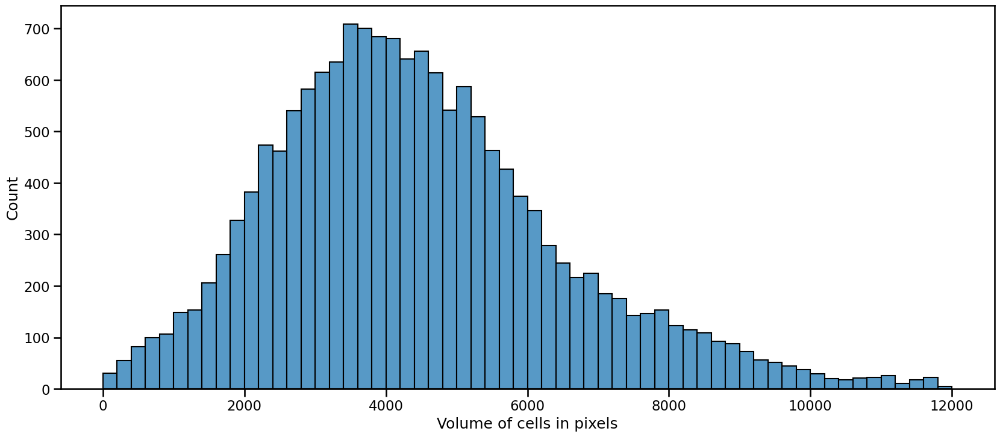

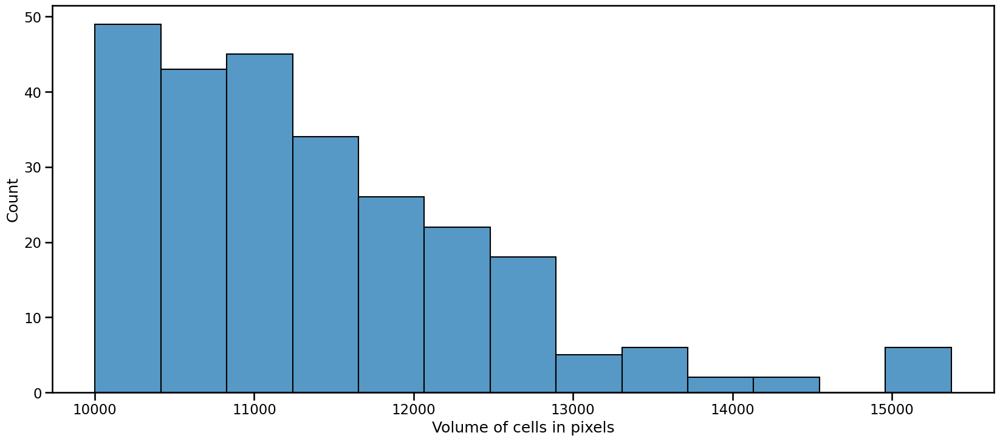

In [14]:
plot_hist(cell_volume_df[cell_volume_df["pixel_vol"] <= 12000]["pixel_vol"].values)
plot_hist(cell_volume_df[cell_volume_df["pixel_vol"] >= 10000]["pixel_vol"].values)

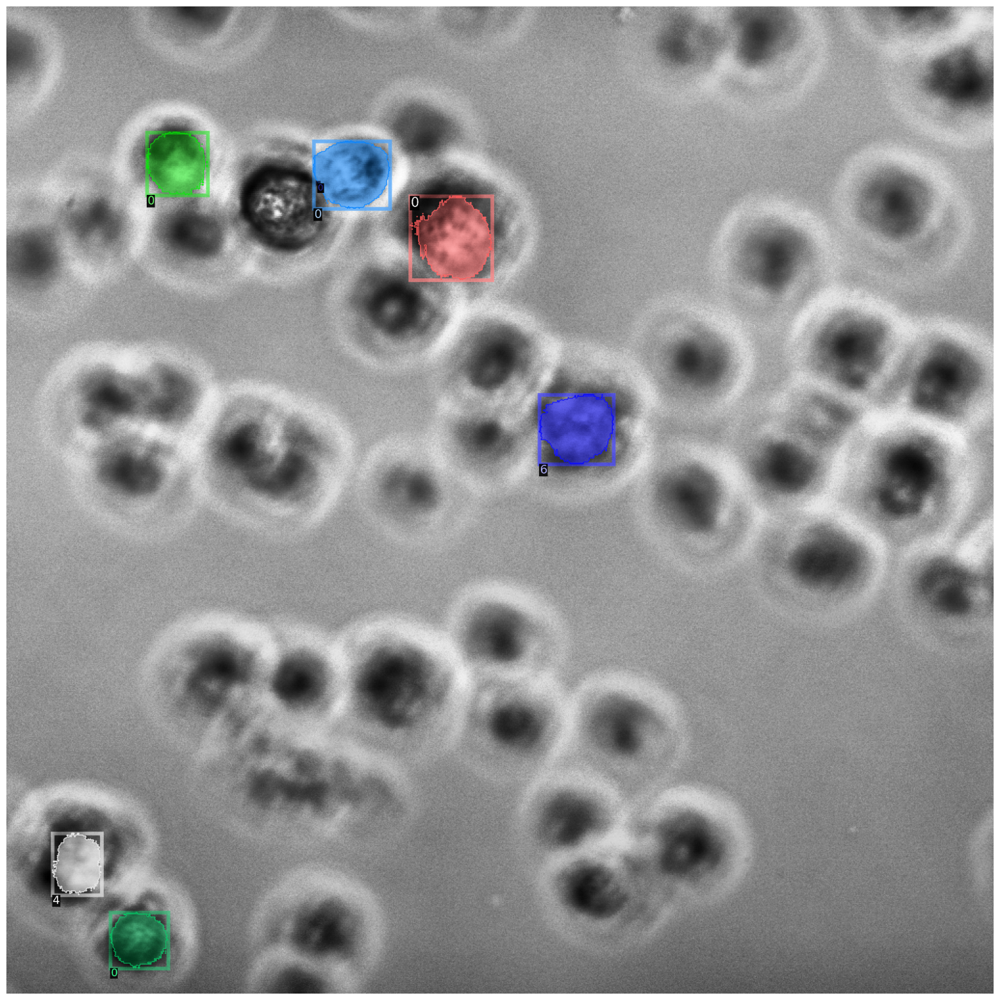

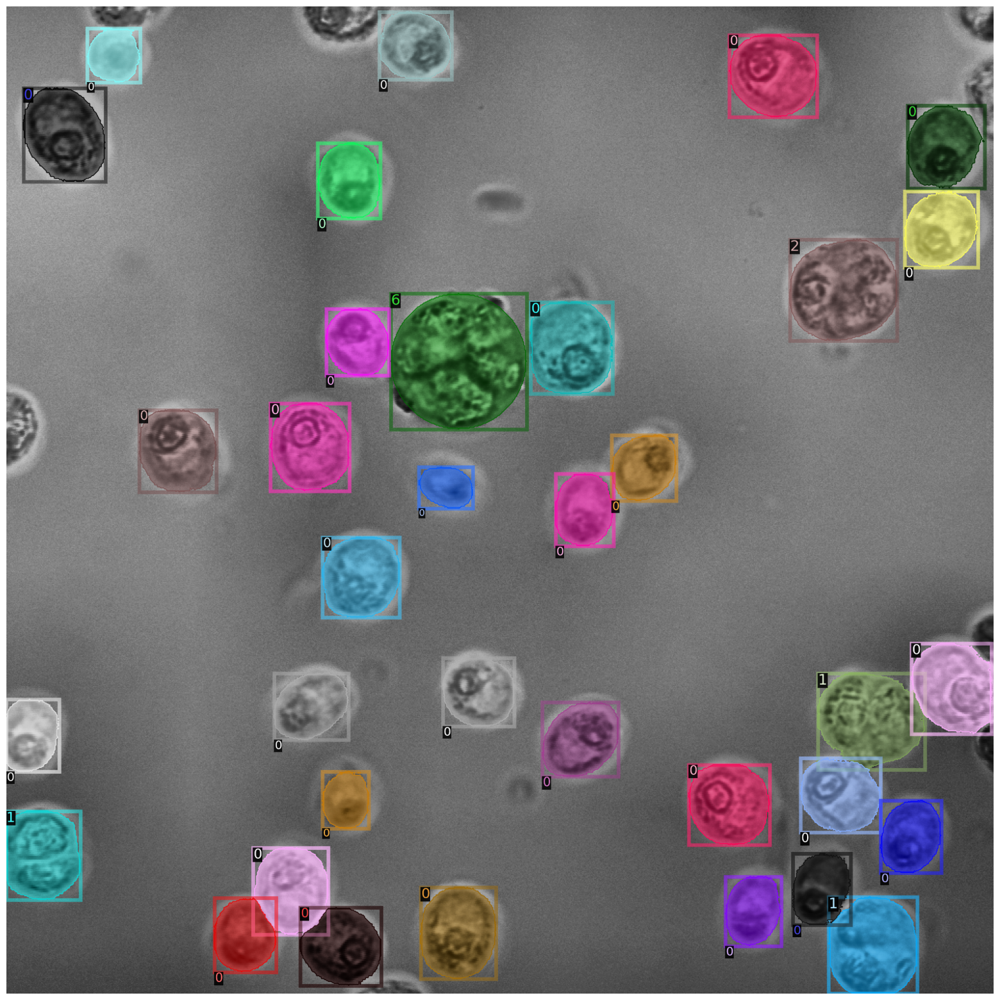

In [15]:
plot_gt(cell_volume_df[cell_volume_df["pixel_vol"] == cell_volume_df["pixel_vol"].min()]["id"].values[0], total_data)
plot_gt(cell_volume_df[cell_volume_df["pixel_vol"] == cell_volume_df["pixel_vol"].max()]["id"].values[0], total_data)

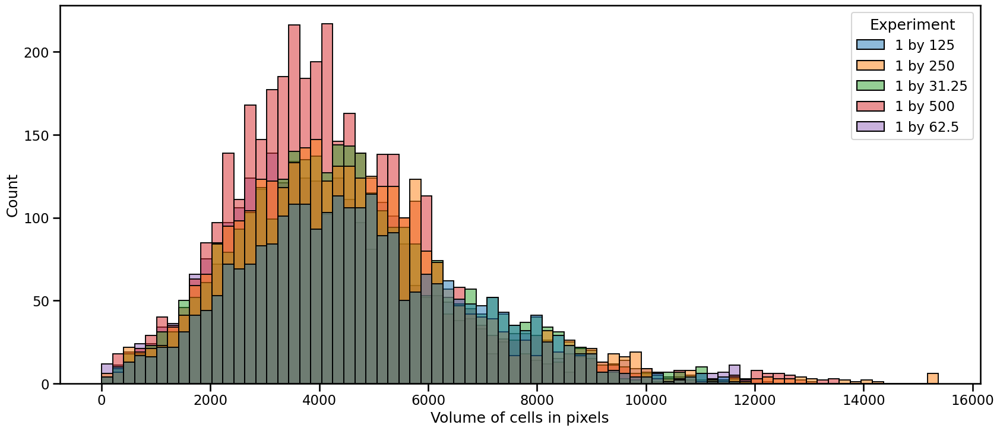

In [16]:

plot_hist_experiments(cell_volume_df)

In [145]:
records = []

CATEGORIES = [
    {
        "id": 0,
        "name": "G1_or_G0",
        "supercategory": "Cell",
    },
    {
        "id": 1,
        "name": "SM_2_cell",
        "supercategory": "Cell",
    },
    {
        "id": 2,
        "name": "SM_4_cell",
        "supercategory": "Cell",
    },
    {
        "id": 3,
        "name": "SM_8_cell",
        "supercategory": "Cell",
    },
    {
        "id": 4,
        "name": "transition_into_2_cell",
        "supercategory": "Cell",
    },
    {
        "id": 5,
        "name": "transition_into_4_cell",
        "supercategory": "Cell",
    },
    {
        "id": 6,
        "name": "transition_into_8_cell",
        "supercategory": "Cell",
    },
    {
        "id": 7,
        "name": "Uncharacterized",
        "supercategory": "Cell",
    },
]



class_map = {cat["id"]:cat["name"] for cat in CATEGORIES}

for image_json in tqdm(total_data):
    w = image_json["width"]
    h = image_json["height"]

    id = image_json["image_id"]
    experiment = id.split("_pos")[0]

    for obj in image_json["annotations"]:
        pixel_vol = polygons_to_bitmask(polygons=obj["segmentation"], height=h, width=w).sum()

        obj_class = class_map[obj["category_id"]]
        records.append({
            "id": id,
            "experiment": experiment,
            "pixel_vol":pixel_vol,
            "obj_class": obj_class,
            "obj_class_id": obj["category_id"],
            "Cell Cycle Stage": obj_class,
        })
        


cell_class_df = pd.DataFrame.from_records(records)

cell_class_df.head()

NameError: name 'total_data' is not defined

0 G1_or_G0 13334 0.8374576058284136 avg cell size 4032.8149092545373


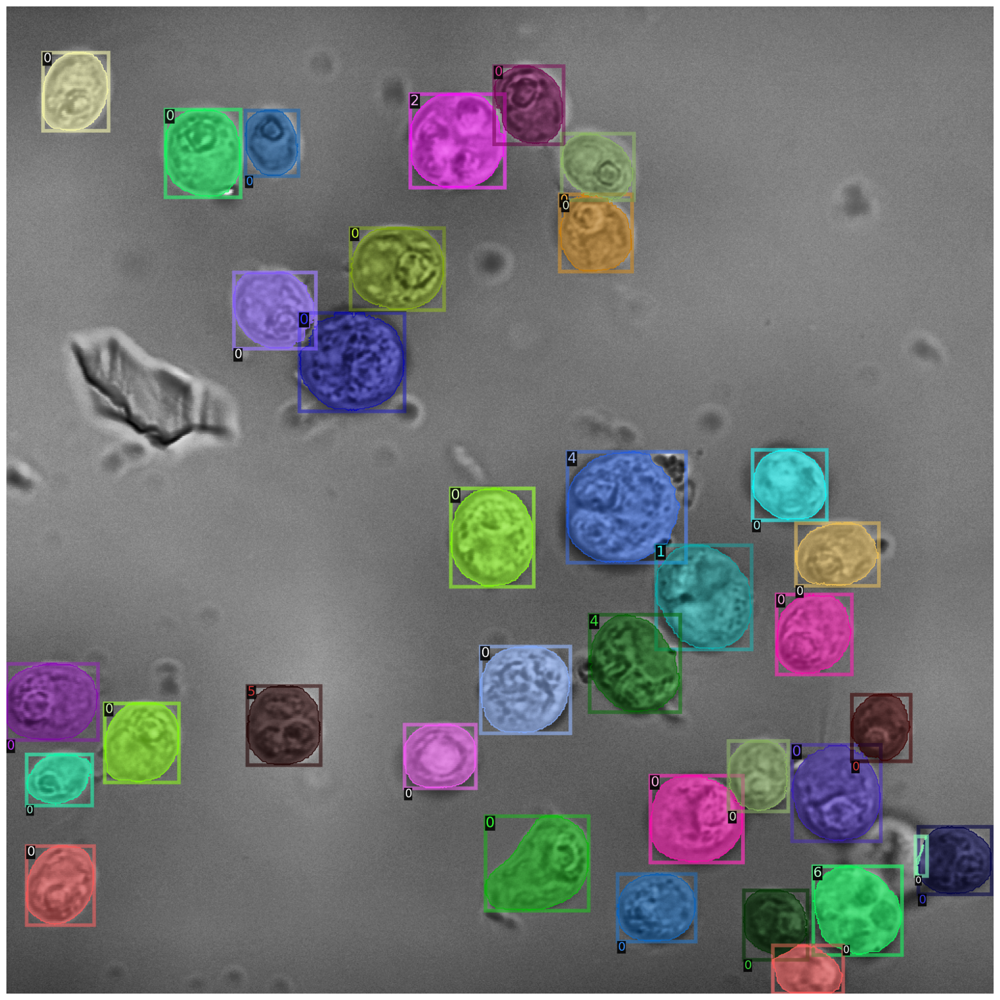


2 SM_4_cell 422 0.026504208014068584 avg cell size 6931.1563981042655


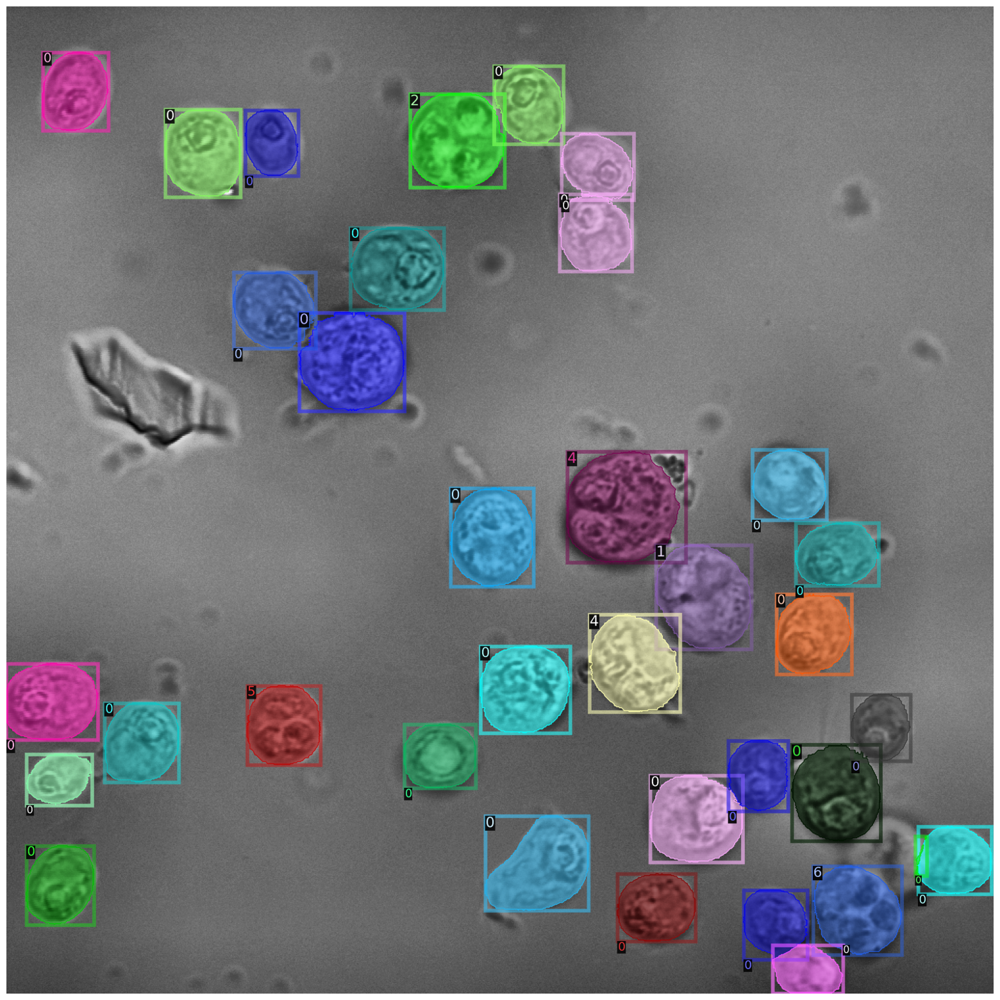


4 transition_into_2_cell 516 0.0324079889461123 avg cell size 6386.178294573643


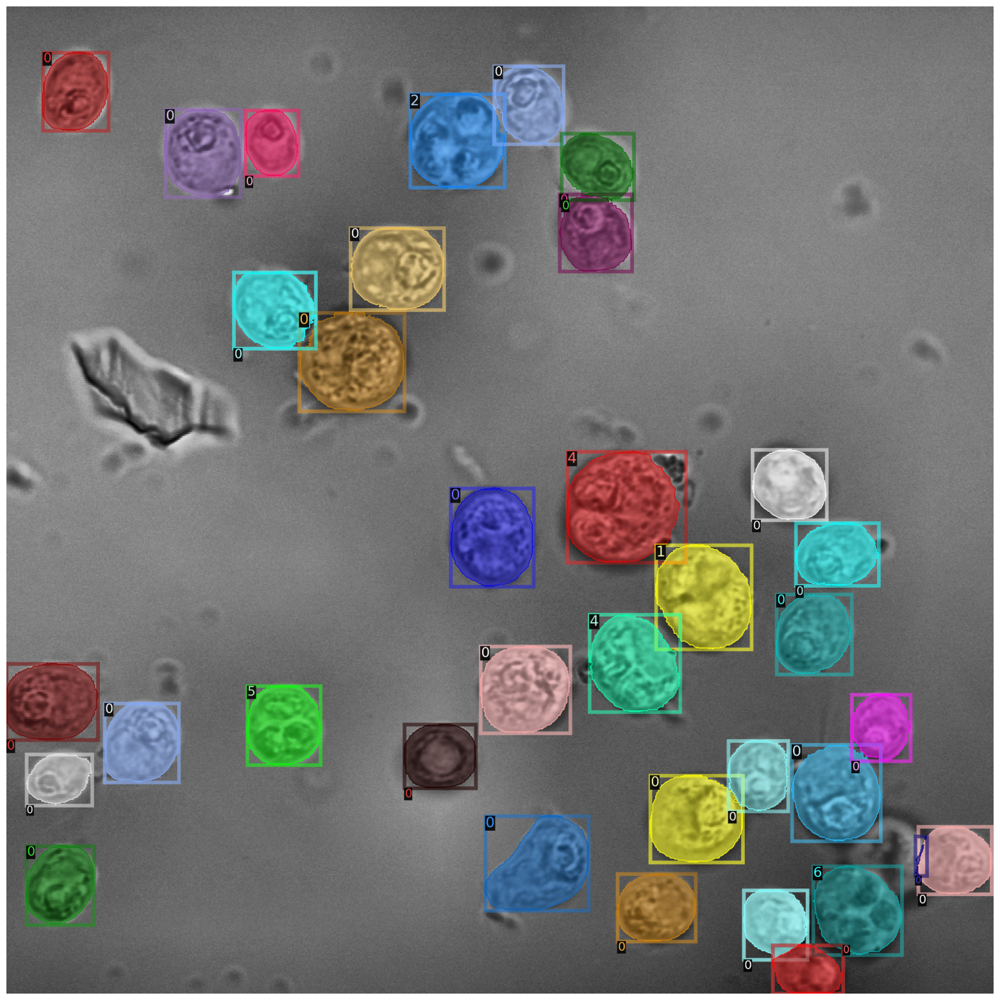


1 SM_2_cell 566 0.03554829795251853 avg cell size 6604.888692579505


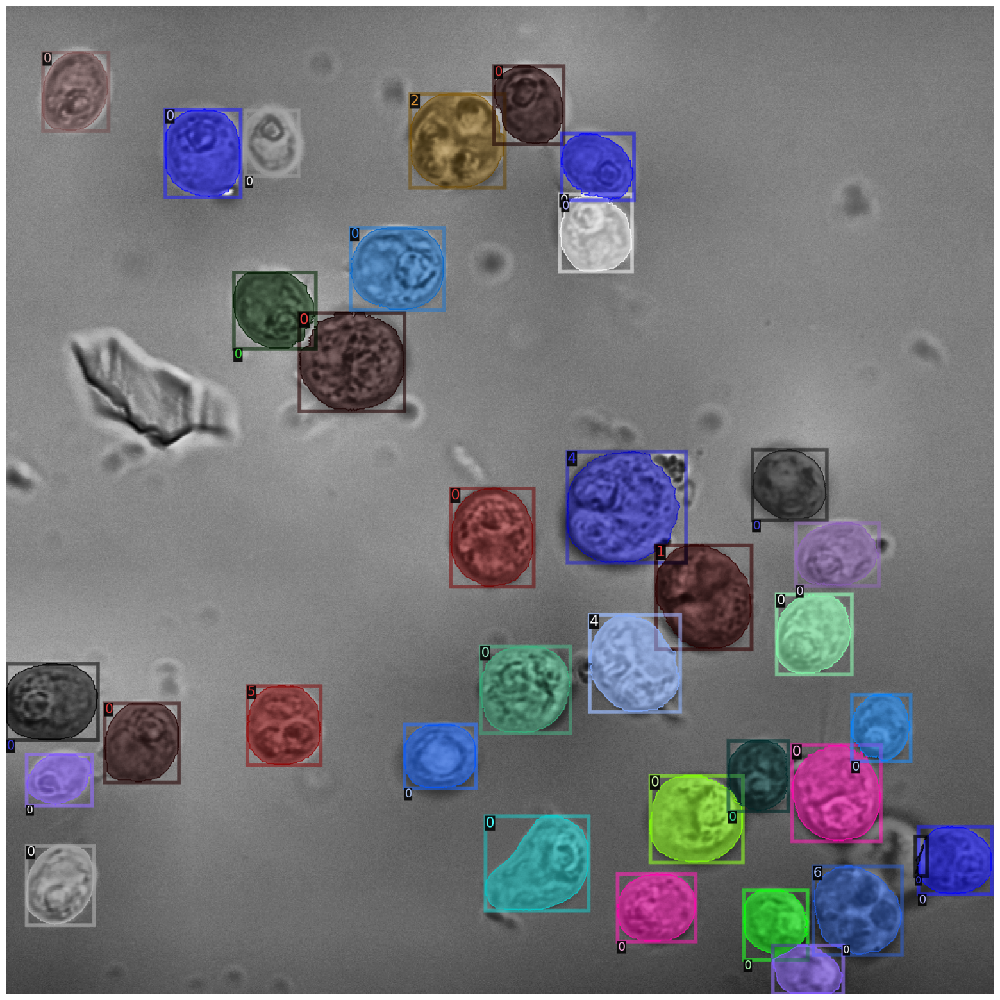


5 transition_into_4_cell 722 0.045346062052505964 avg cell size 6610.7409972299165


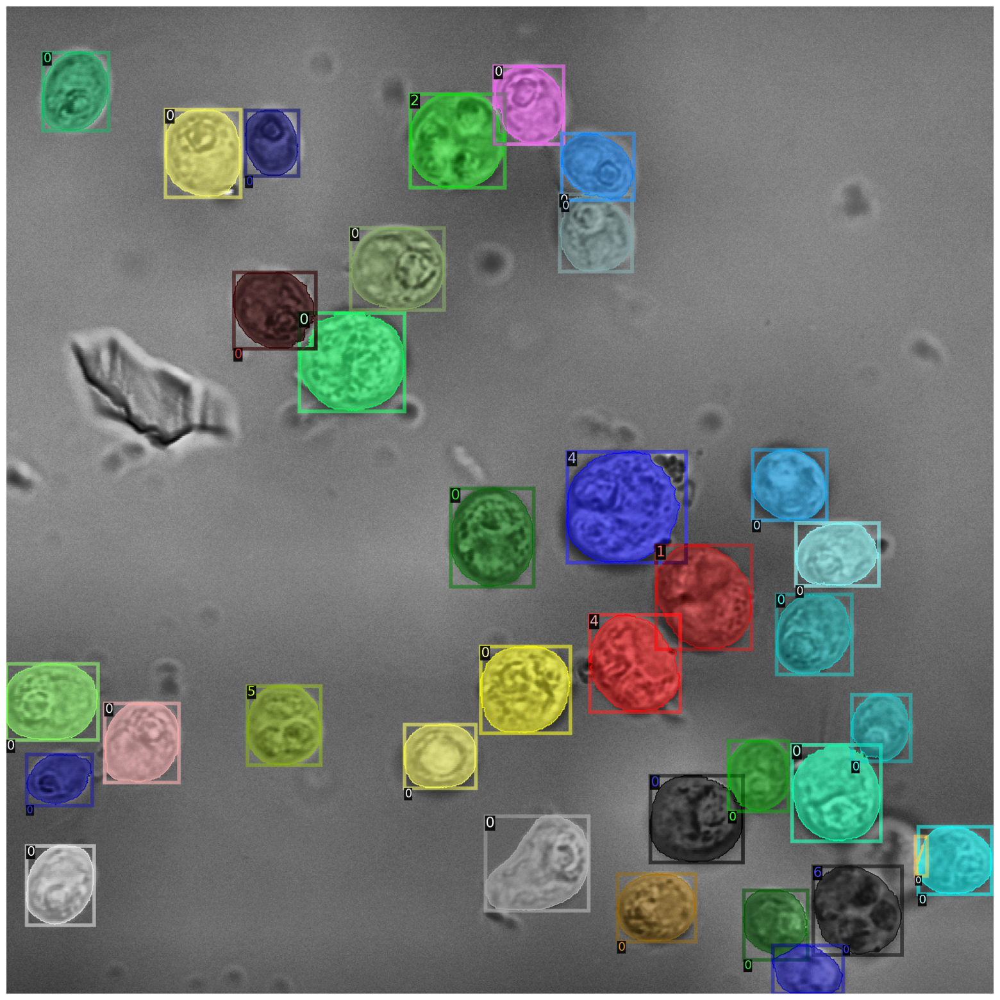


6 transition_into_8_cell 250 0.015701545032031153 avg cell size 7677.62


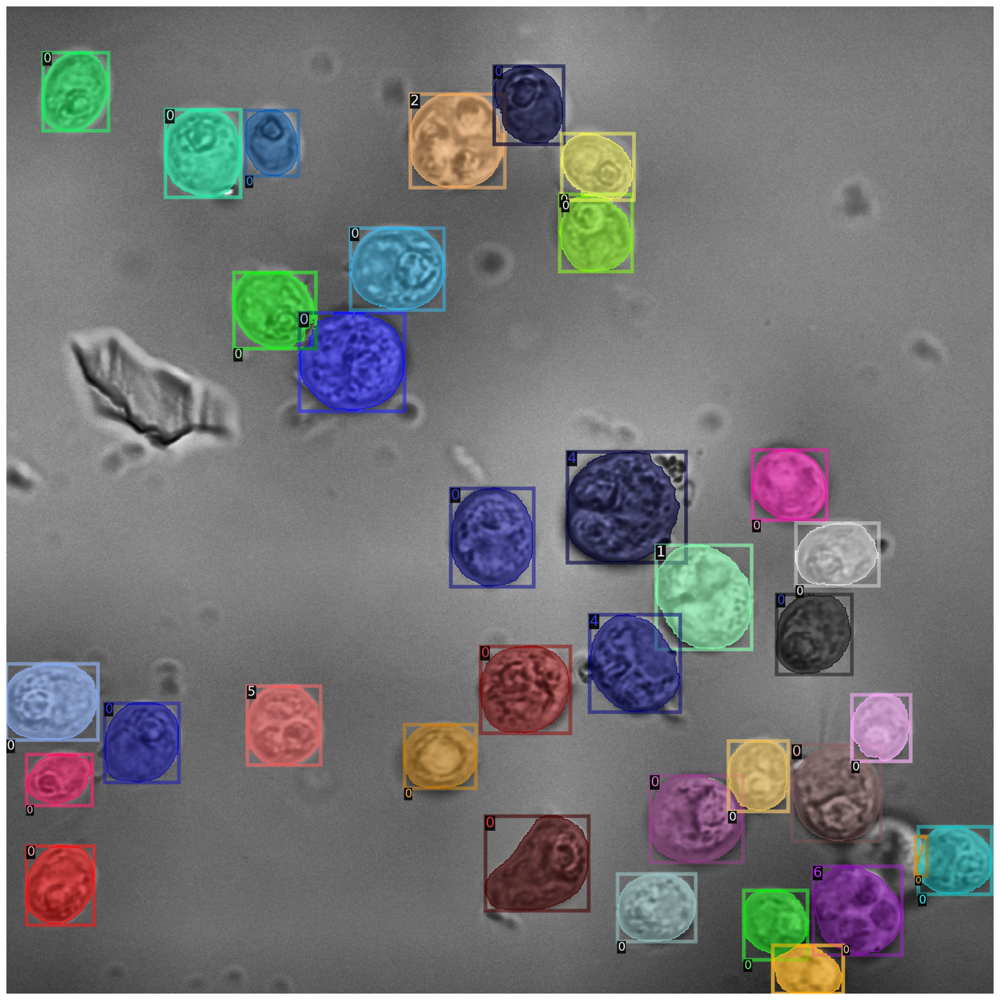


3 SM_8_cell 84 0.005275719130762467 avg cell size 8343.309523809523


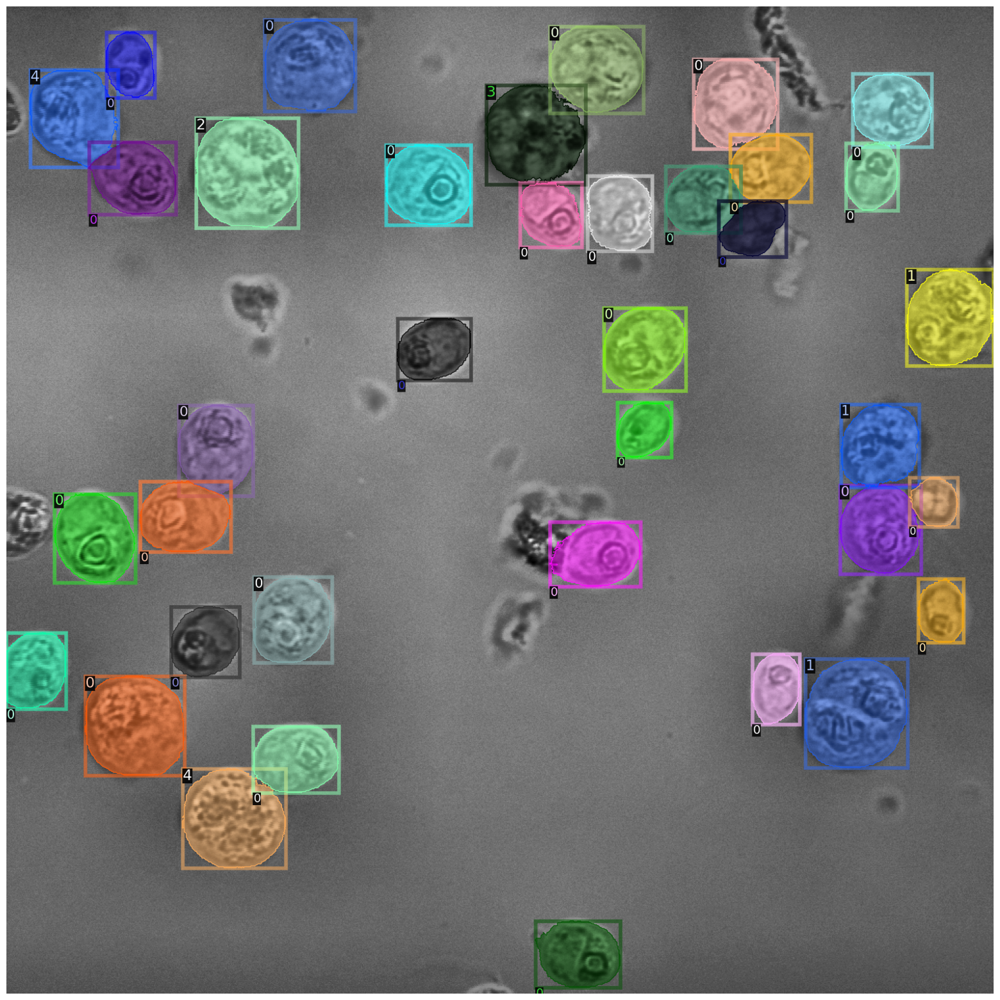


7 Uncharacterized 28 0.001758573043587489 avg cell size 4218.75


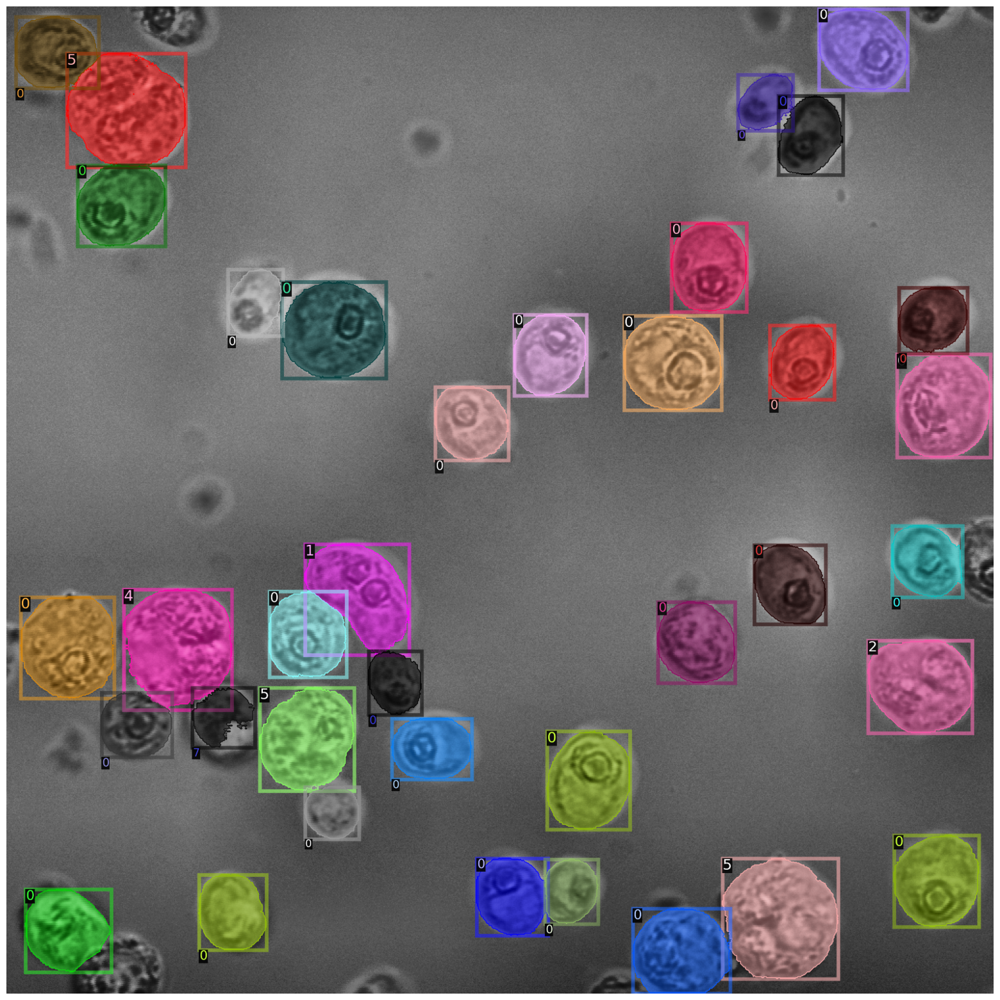

In [18]:
for c in cell_class_df["obj_class"].unique():

    print(cell_class_df[cell_class_df["obj_class"] == c]["obj_class_id"].values[0], c, len(cell_class_df[cell_class_df["obj_class"] == c]), len(cell_class_df[cell_class_df["obj_class"] == c])/len(cell_class_df), "avg cell size", cell_class_df[cell_class_df["obj_class"] == c]["pixel_vol"].mean())
    plot_gt(
        cell_class_df[cell_class_df["obj_class"] == c]["id"].values[0]
        , total_data)
    print("")

In [19]:
cell_class_df[cell_class_df["obj_class"] == "transition_into_8_cell"]

,id,experiment,pixel_vol,obj_class,obj_class_id,Cell Cycle Stage
30,1 by 125_pos_1_10,1 by 125,6356,transition_into_8_cell,6,transition_into_8_cell
65,1 by 125_pos_1_11,1 by 125,6599,transition_into_8_cell,6,transition_into_8_cell
99,1 by 125_pos_1_12,1 by 125,6999,transition_into_8_cell,6,transition_into_8_cell
134,1 by 125_pos_1_13,1 by 125,7101,transition_into_8_cell,6,transition_into_8_cell
169,1 by 125_pos_1_14,1 by 125,7226,transition_into_8_cell,6,transition_into_8_cell
...,...,...,...,...,...,...
14076,1 by 250_pos_1_5,1 by 250,10912,transition_into_8_cell,6,transition_into_8_cell
14111,1 by 250_pos_1_6,1 by 250,11783,transition_into_8_cell,6,transition_into_8_cell
14146,1 by 250_pos_1_7,1 by 250,12452,transition_into_8_cell,6,transition_into_8_cell
14181,1 by 250_pos_1_8,1 by 250,12852,transition_into_8_cell,6,transition_into_8_cell


In [7]:
dataset = CHLAMY_DATASET
test_dataset_name = dataset + "_test"
config_name = "chlamy_random_al"

model_path = "/home/florian/GitRepos/activeCell-ACDC/output/chlamy_random_al/model_training"

In [8]:
wandb.init(
    project="activeCell-ACDC",
    name="",
    sync_tensorboard=True,
    mode="disabled",
)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


In [77]:
default_cfg = get_config(config_name)
cfg = default_cfg
cfg.OUTPUT_DIR = "./al_output/classes_acdc_large_al"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.05#.4

In [10]:
model = load_model(cfg, os.path.join(model_path, "best_model.pth"))

In [24]:
results = do_test(cfg, model=model, logger=logger)

/home/florian/GitRepos/activeCell-ACDC/ac_acdc_env/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.225
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.021
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.026
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.019
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.066
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.296
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.039
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.330
 Average Recall     (AR) @[ IoU=0.50:0.

In [25]:
results

OrderedDict([('segm',
              OrderedDict([('AP', 15.746652499229832),
                           ('AP50', 23.429842823576305),
                           ('AP75', 17.784080538410578),
                           ('APs', 1.2198828834711226),
                           ('APm', 15.469684720296748),
                           ('APl', 17.15387716093267),
                           ('AP-G1_or_G0', 61.76826947280926),
                           ('AP-SM_2_cell', 10.082024163186604),
                           ('AP-SM_4_cell', 11.904799051264765),
                           ('AP-SM_8_cell', 0.3712871287128713),
                           ('AP-transition_into_2_cell', 5.677526308976281),
                           ('AP-transition_into_4_cell', 15.354502326538046),
                           ('AP-transition_into_8_cell', 5.068159043121008),
                           ('AP-Uncharacterized', nan)])),
             ('bbox',
              OrderedDict([('AP', 7.401958763060228),
                 

In [26]:
evaluator = SingleImageCOCOEvaluator(test_dataset_name, cfg, False,output_dir="./" )
val_loader = build_detection_test_loader(cfg, test_dataset_name)

#Use the created predicted model in the previous step
res = inference_on_dataset(model, val_loader, evaluator)

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.144
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.375
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.004
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.473
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.498
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.498
 Average Recall     (AR) @[ IoU=0.50

In [27]:
CATEGORIES

[{'id': 0, 'name': 'G1_or_G0', 'supercategory': 'Cell'},
 {'id': 1, 'name': 'SM_2_cell', 'supercategory': 'Cell'},
 {'id': 2, 'name': 'SM_4_cell', 'supercategory': 'Cell'},
 {'id': 3, 'name': 'SM_8_cell', 'supercategory': 'Cell'},
 {'id': 4, 'name': 'transition_into_2_cell', 'supercategory': 'Cell'},
 {'id': 5, 'name': 'transition_into_4_cell', 'supercategory': 'Cell'},
 {'id': 6, 'name': 'transition_into_8_cell', 'supercategory': 'Cell'},
 {'id': 7, 'name': 'Uncharacterized', 'supercategory': 'Cell'}]

In [28]:
segm_ap_dict = []
for key in res.keys():

    tmp_dict = {
        "image_id": key,
        "segm_ap": res[key]["segm"]["AP"]
    }

    for cat in CATEGORIES:
        tmp_dict[cat["name"]] = res[key]["segm"]["AP-" + cat["name"]]

    segm_ap_dict.append(tmp_dict)


df = pd.DataFrame.from_records(segm_ap_dict).sort_values("segm_ap")
df["frame_id"] = df["image_id"].str.split("_").str[-1].astype(int)
df[df["frame_id"] < 4]["segm_ap"].mean()

nan

1 by 125_pos_4_23 segm_ap: 10.22142967429575
1 by 125_pos_4_25 segm_ap: 10.428414269998427
1 by 125_pos_4_22 segm_ap: 14.777432807411655


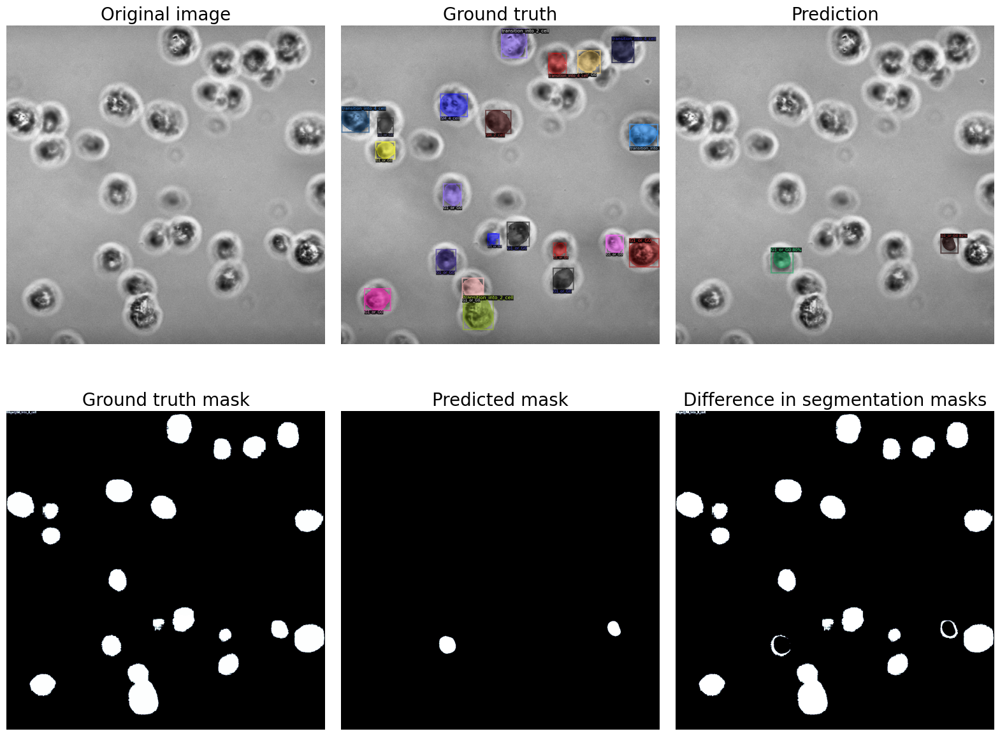

1 by 500_pos_1_22 segm_ap: 18.039436069042445


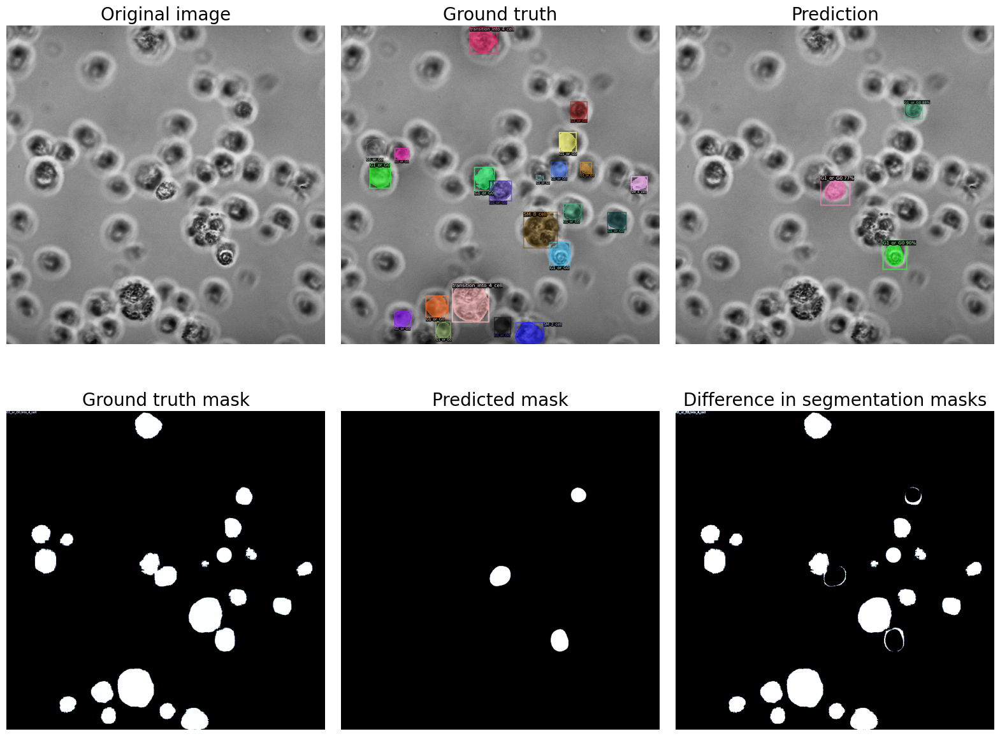

1 by 125_pos_4_24 segm_ap: 18.567939651107963


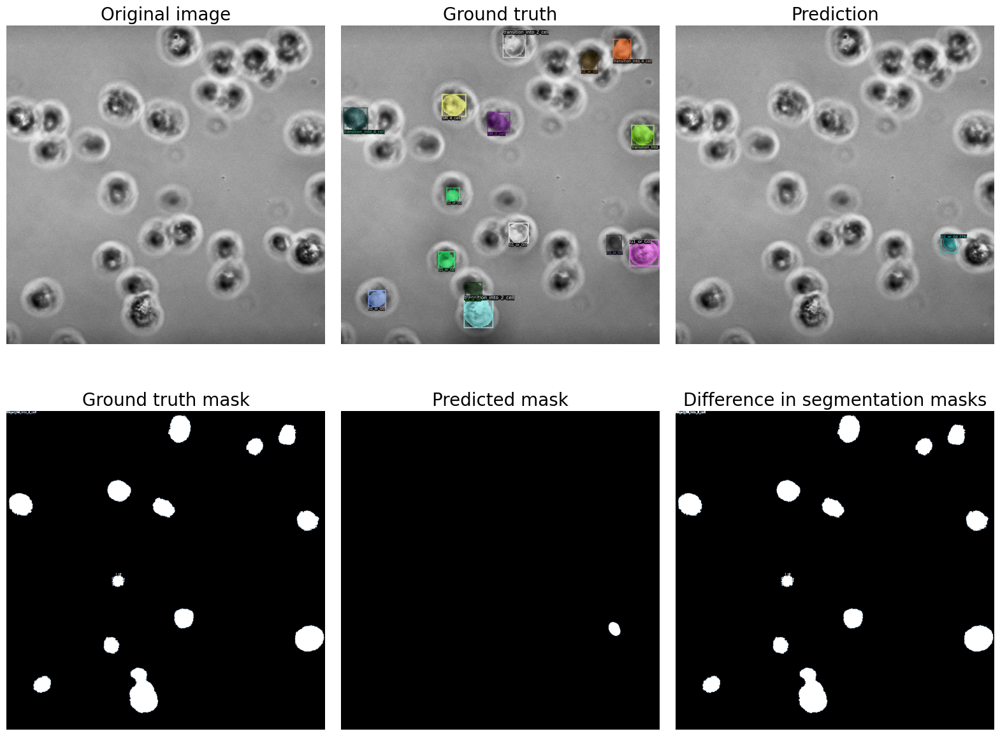

In [33]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
for record in df.head().values:
    image_id = record[0]
    segm_ap = record[1]
    print(f"{image_id} segm_ap: {segm_ap}")

    image_json = get_json_by_id(image_id, test_data)  
    try:
        plot_prediction(image_json, test_dataset_name, cfg, model_path=os.path.join(model_path, "best_model.pth"))
    except:
        pass

In [30]:
!ls data/chlamy_dataset/test/cell_acdc_coco_ds.json

data/chlamy_dataset/test/cell_acdc_coco_ds.json


In [31]:
"""with open("data/chlamy_dataset/train/cell_acdc_coco_ds.json", "r") as file:
    js = json.load(file)

images = []

for im in js["images"]:
    if int(im["id"].split("_")[-1]) >=5 and int(im["id"].split("_")[-1]) <= 25:
        images.append(im)
annotations = []
for im in js["annotations"]:
    if int(im["image_id"].split("_")[-1]) >=5 and int(im["image_id"].split("_")[-1]) <= 25:
        annotations.append(im)

js["images"] = images
js["annotations"] = annotations
with open("data/chlamy_dataset/train/cell_acdc_coco_ds.json", "w") as file:
    json.dump(js, file)"""

'with open("data/chlamy_dataset/train/cell_acdc_coco_ds.json", "r") as file:\n    js = json.load(file)\n\nimages = []\n\nfor im in js["images"]:\n    if int(im["id"].split("_")[-1]) >=5 and int(im["id"].split("_")[-1]) <= 25:\n        images.append(im)\nannotations = []\nfor im in js["annotations"]:\n    if int(im["image_id"].split("_")[-1]) >=5 and int(im["image_id"].split("_")[-1]) <= 25:\n        annotations.append(im)\n\njs["images"] = images\njs["annotations"] = annotations\nwith open("data/chlamy_dataset/train/cell_acdc_coco_ds.json", "w") as file:\n    json.dump(js, file)'

In [32]:
df["frame_id"].unique()

array([23, 25, 22, 24, 21,  6, 20,  5, 19, 17, 15,  8, 18,  9, 12, 10, 16,
       14, 13, 11,  7])

In [5]:
train_data[0]

{'file_name': '/home/florian/GitRepos/activeCell-ACDC/data/chlamy_dataset/train/images/1 by 125_pos_1_10.png',
 'height': 1024,
 'width': 1024,
 'image_id': '1 by 125_pos_1_10',
 'annotations': [{'iscrowd': 0,
   'bbox': [37.0, 47.0, 69.0, 82.0],
   'category_id': 0,
   'segmentation': [[72.0,
     128.5,
     71.0,
     128.5,
     70.0,
     128.5,
     69.0,
     128.5,
     68.0,
     128.5,
     67.0,
     128.5,
     66.0,
     128.5,
     65.0,
     128.5,
     64.0,
     128.5,
     63.0,
     128.5,
     62.0,
     128.5,
     61.0,
     128.5,
     60.0,
     128.5,
     59.0,
     128.5,
     58.5,
     128.0,
     58.0,
     127.5,
     57.0,
     127.5,
     56.5,
     127.0,
     56.0,
     126.5,
     55.5,
     127.0,
     55.0,
     127.5,
     54.5,
     127.0,
     54.0,
     126.5,
     53.0,
     126.5,
     52.0,
     126.5,
     51.0,
     126.5,
     50.0,
     126.5,
     49.0,
     126.5,
     48.5,
     126.0,
     48.0,
     125.5,
     47.0,
     125.5,
   

In [78]:


predictor = DefaultPredictor(cfg)


im = cv2.imread(train_data[0]["file_name"])

outputs = predictor(im)

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (9, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (32, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (32,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (8, 256, 1, 1) 

In [79]:
outputs["instances"][0].pred_masks.to("cpu").detach().numpy()

array([[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]]])

In [29]:
train_data[0]["height"]

{'file_name': '/home/florian/GitRepos/activeCell-ACDC/data/chlamy_dataset/train/images/1 by 125_pos_1_10.png',
 'height': 1024,
 'width': 1024,
 'image_id': '1 by 125_pos_1_10',
 'annotations': [{'iscrowd': 0,
   'bbox': [37.0, 47.0, 69.0, 82.0],
   'category_id': 0,
   'segmentation': [[72.0,
     128.5,
     71.0,
     128.5,
     70.0,
     128.5,
     69.0,
     128.5,
     68.0,
     128.5,
     67.0,
     128.5,
     66.0,
     128.5,
     65.0,
     128.5,
     64.0,
     128.5,
     63.0,
     128.5,
     62.0,
     128.5,
     61.0,
     128.5,
     60.0,
     128.5,
     59.0,
     128.5,
     58.5,
     128.0,
     58.0,
     127.5,
     57.0,
     127.5,
     56.5,
     127.0,
     56.0,
     126.5,
     55.5,
     127.0,
     55.0,
     127.5,
     54.5,
     127.0,
     54.0,
     126.5,
     53.0,
     126.5,
     52.0,
     126.5,
     51.0,
     126.5,
     50.0,
     126.5,
     49.0,
     126.5,
     48.5,
     126.0,
     48.0,
     125.5,
     47.0,
     125.5,
   

In [25]:
from detectron2.structures.masks import polygons_to_bitmask

In [81]:

matches = {}
instances = train_data[0]["annotations"]

for i in range(len(outputs["instances"])):
    matches[i] = []
    output = outputs["instances"][i]
    for instance in instances:
        mask = polygons_to_bitmask(instance["segmentation"], height=train_data[0]["height"], width=train_data[0]["width"])
        pred = output.pred_masks.to("cpu").detach().numpy()
        iou = np.sum(mask & pred)/ np.sum(mask | pred)

        if iou > 0.2:
            matches[i].append(iou)
    if len(matches[i]) > 0:
        print(matches[i])

[0.2780439451511647]
[0.42766407904022585]
[0.31042128603104213]
[0.5098163394553515]
[0.27988223748773305]
[0.5049749437141404]
[0.4264029728538137]
[0.38091594066399814]
[0.25899754476315945]
[0.25416442772702846]
[0.2885181550539745]
[0.44607541038713655]
[0.32672280079769556]
[0.33641349260010517]
[0.3537979094076655]
[0.27178873344804366, 0.45374008716153463]
[0.24851948051948053]


In [101]:

matches = {}

instances = train_data[0]["annotations"]

for j in range(len(instances)):
    instance = instances[j]
    matches[j] = []
    
    for i in range(len(outputs["instances"])):
        output = outputs["instances"][i]
        mask = polygons_to_bitmask(instance["segmentation"], height=train_data[0]["height"], width=train_data[0]["width"])
        pred = output.pred_masks.to("cpu").detach().numpy()
        iou = np.sum(mask & pred)/ np.sum(mask | pred)

        if iou > 0.2:
            matches[j].append(
                {
                    "instance": instance,
                    "prediction": output,
                    "iou": iou,
                    "pred_class": int(output.pred_classes.to("cpu").detach().numpy()),
                    "true_class": instance["category_id"],
                    "detected": True,
                }
            )
            break
    if len(matches[j]) == 0: 
        matches[j].append(
                {
                    "instance": instance,
                    "detected": False
                }
            )

    if len(matches[j]) > 0 or True:
        print(matches[j])

[{'iou': 0.25899754476315945, 'pred_class': 6, 'true_class': 0, 'detected': True}]
[{'instance': {'iscrowd': 0, 'bbox': [506.0, 62.0, 72.0, 81.0], 'category_id': 0, 'segmentation': [[557.0, 142.5, 556.5, 142.0, 556.0, 141.5, 555.0, 141.5, 554.0, 141.5, 553.0, 141.5, 552.5, 142.0, 552.0, 142.5, 551.5, 142.0, 551.0, 141.5, 550.5, 142.0, 550.0, 142.5, 549.5, 142.0, 549.0, 141.5, 548.5, 142.0, 548.0, 142.5, 547.5, 142.0, 547.0, 141.5, 546.5, 142.0, 546.0, 142.5, 545.5, 142.0, 545.0, 141.5, 544.0, 141.5, 543.0, 141.5, 542.0, 141.5, 541.0, 141.5, 540.0, 141.5, 539.5, 141.0, 539.0, 140.5, 538.0, 140.5, 537.0, 140.5, 536.0, 140.5, 535.0, 140.5, 534.5, 140.0, 534.5, 139.0, 534.0, 138.5, 533.5, 139.0, 533.0, 139.5, 532.5, 139.0, 532.5, 138.0, 532.0, 137.5, 531.0, 137.5, 530.0, 137.5, 529.5, 137.0, 529.0, 136.5, 528.0, 136.5, 527.0, 136.5, 526.5, 136.0, 526.5, 135.0, 526.0, 134.5, 525.0, 134.5, 524.5, 134.0, 524.5, 133.0, 524.0, 132.5, 523.0, 132.5, 522.5, 132.0, 522.0, 131.5, 521.0, 131.5, 520.5

In [91]:
output

Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[ 862.5319,  258.9258, 1024.0000,  974.8091]], device='cuda:0')), scores: tensor([0.1620], device='cuda:0'), pred_classes: tensor([5], device='cuda:0'), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]], device='cuda:0')])

In [93]:
instances[0]["category_id"]

0

In [97]:
int(output.pred_classes.to("cpu").detach().numpy())

5

In [129]:


evaluator = AccuracyEvaluator(test_dataset_name, cfg, False,output_dir="./" )
val_loader = build_detection_test_loader(cfg, test_dataset_name)

#Use the created predicted model in the previous step
res = inference_on_dataset(model, val_loader, evaluator)

1 by 125_pos_4_10
1 by 125_pos_4_11
1 by 125_pos_4_12
1 by 125_pos_4_13
1 by 125_pos_4_14
1 by 125_pos_4_15
1 by 125_pos_4_16
1 by 125_pos_4_17
1 by 125_pos_4_18
1 by 125_pos_4_19
1 by 125_pos_4_20
1 by 125_pos_4_21
1 by 125_pos_4_22
1 by 125_pos_4_23
1 by 125_pos_4_24
1 by 125_pos_4_25
1 by 125_pos_4_26
1 by 125_pos_4_27
1 by 125_pos_4_28
1 by 125_pos_4_29
1 by 125_pos_4_3
1 by 125_pos_4_4
1 by 125_pos_4_5
1 by 125_pos_4_6
1 by 125_pos_4_7
1 by 125_pos_4_8
1 by 125_pos_4_9
1 by 250_pos_1_10
1 by 250_pos_1_11
1 by 250_pos_1_12
1 by 250_pos_1_13
1 by 250_pos_1_14
1 by 250_pos_1_15
1 by 250_pos_1_16
1 by 250_pos_1_17
1 by 250_pos_1_18
1 by 250_pos_1_19
1 by 250_pos_1_2
1 by 250_pos_1_20
1 by 250_pos_1_21
1 by 250_pos_1_22
1 by 250_pos_1_23
1 by 250_pos_1_24
1 by 250_pos_1_25
1 by 250_pos_1_26
1 by 250_pos_1_27
1 by 250_pos_1_28
1 by 250_pos_1_3
1 by 250_pos_1_4
1 by 250_pos_1_5
1 by 250_pos_1_6
1 by 250_pos_1_7
1 by 250_pos_1_8
1 by 250_pos_1_9
1 by 500_pos_1_10
1 by 500_pos_1_11
1 by 50

In [148]:
"""results = []
for key in list(res.keys()):
    for obj_key in res[key].keys():
        res_obj = res[key][obj_key][0]
        if res_obj["detected"]:
        
            results.append({
                "image_id": key,
                "object_id": obj_key,
                "iou": res_obj["iou"],
                "pred_class": res_obj["pred_class"],
                "true_class": res_obj["true_class"],
            })"""
res_df = pd.DataFrame.from_records(res)
sum(res_df["detected"])/len(res_df["detected"])
res_df["iou"].mean()

res_df["class_right"] = res_df["pred_class"] == res_df["true_class"]

sum(res_df["class_right"] )/len(res_df["class_right"])

for c in res_df["true_class"].unique():
    print(
        CATEGORIES[int(c)]["name"],
        sum(res_df[res_df["true_class"] == c]["class_right"] )/len(res_df[res_df["true_class"] == c]["class_right"]))


transition_into_4_cell 0.4460431654676259
transition_into_2_cell 0.0
G1_or_G0 0.9973096583266075
SM_4_cell 0.0
SM_2_cell 0.0
transition_into_8_cell 0.0
SM_8_cell 0.0


ValueError: cannot convert float NaN to integer

In [114]:
res[list(res.keys())[0]].keys()

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25])

In [119]:
train_data[0]["annotations"][0].keys()

dict_keys(['iscrowd', 'bbox', 'category_id', 'segmentation', 'bbox_mode'])

In [122]:
res_df = pd.DataFrame.from_records(results)

In [128]:
res_df.groupby(by=["pred_class","true_class"]).mean()

/tmp/ipykernel_5357/3847769188.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  res_df.groupby(by=["pred_class","true_class"]).mean()


object_id       iou
pred_class true_class                     
0          0           21.071217  0.857146
           1           29.721854  0.874720
           2           12.044776  0.892594
           4           19.629630  0.882908
           5            6.116883  0.880040
           6           34.000000  0.283302
5          0           17.200000  0.864027
           1           21.000000  0.879154
           2           21.093023  0.924982
           3           27.000000  0.884297
           4           11.611111  0.885322
           5           15.903226  0.917792
           6           34.000000  0.902742

In [125]:
res_df.groupby("true_class").count()

,image_id,object_id,iou,pred_class
true_class,,,,
0,3717,3717,3717,3717
1,164,164,164,164
2,110,110,110,110
3,29,29,29,29
4,216,216,216,216
5,139,139,139,139
6,27,27,27,27
